# COVID-19 Map by Location
[Work in progress]

This notebook analyzes available 3D protein structures for Coronaviruses in the [Protein Data Bank](https://www.wwpdb.org/).

In [1]:
from urllib.request import urlopen
import json
import datetime
import pandas as pd
import ipywidgets as widgets
from py2neo import Graph
import plotly.express as px

In [2]:
pd.options.display.max_rows = None  # display all rows
pd.options.display.max_columns = None  # display all columsns

In [3]:
# Define time period for averaging data
TIME_PERIOD = 7 # days

In [4]:
# Load US County boundaries
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

#### Connect to COVID-19-Community Knowledge Graph

In [5]:
graph = Graph("bolt://132.249.238.185:7687", user="reader", password="demo")

#### Get lastest available time period for case data from JHU

In [6]:
query = """
MATCH (:Admin2)<-[:REPORTED_IN]-(c:Cases{source: 'JHU'}) 
RETURN max(c.date)  // returns a neotime.Date object
"""
end_date = graph.evaluate(query).to_native() # convert to datetime.date object

In [7]:
start_date = end_date - datetime.timedelta(days=TIME_PERIOD)
print(f'Time period: {start_date} - {end_date}')

Time period: 2021-02-07 - 2021-02-14


### 

In [8]:
query = """
MATCH (o:Outbreak{id: "COVID-19"})<-[:RELATED_TO]-(n:Cases{date: date($end_date), source: 'JHU'})-[:REPORTED_IN]->(c:Country)
RETURN c.name as country, c.iso3 as iso3, n.cases as cases, n.deaths as deaths
ORDER BY cases DESC;
"""
country_df = graph.run(query, end_date=end_date).to_data_frame()
country_df.head()

,country,iso3,cases,deaths
0,United States,USA,27639538,485332
1,India,IND,10916589,155732
2,Brazil,BRA,9834513,239245
3,United Kingdom,GBR,4038078,117166
4,Russia,RUS,4026506,78825


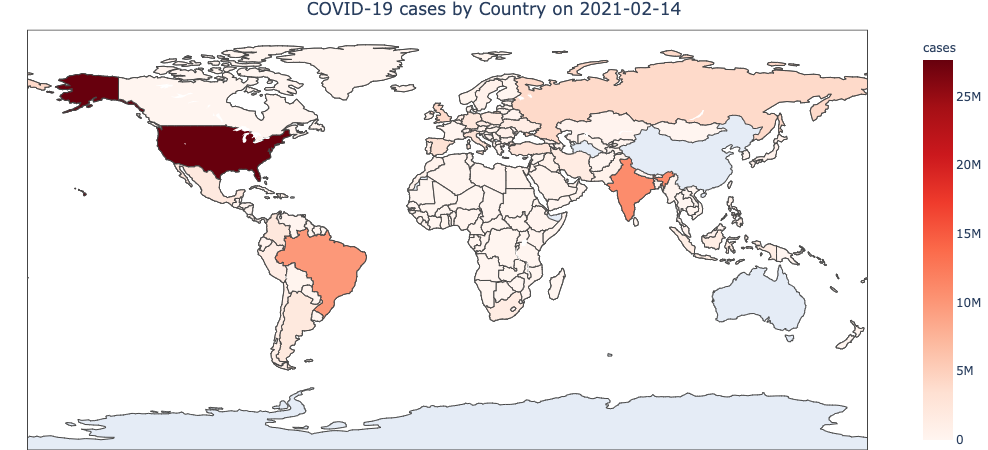

In [9]:
fig = px.choropleth(country_df, locations="iso3",
                    color="cases",
                    hover_name="country",
                    hover_data=['cases', 'deaths'],
                    color_continuous_scale=px.colors.sequential.Reds)
fig.update_layout(
    title_text = f'COVID-19 cases by Country on {end_date}',
    title_x=0.5,
    margin={"r":0,"l":0,"t":30,"b":0}
)
fig.show()

### Number of Cases in US Counties

In [10]:
country = 'United States'

In [11]:
query = """
// get all counties (admin2) in a state (admin1)
MATCH (a2:Admin2)-[:IN]->(a1:Admin1)-[:IN]->(:Country{name: $country})

// get COVID-19 cases for counties
MATCH (a2)<-[:REPORTED_IN]-(c:Cases{source: 'JHU'}) 
WHERE c.date = date($date)

// get demographics for counties
MATCH (a2)-[:HAS_DEMOGRAPHICS]->(d:Demographics) 

// aggregate data by state
RETURN a2.name AS name, a2.stateFips + a2.fips as fips, c.date AS date, 
       c.cases*100000.0/d.totalPopulation AS caseRate, 
       c.deaths*100000.0/d.totalPopulation AS deathRate,
       c.cases AS cases,
       c.deaths AS deaths,
       d.totalPopulation AS population
       
ORDER BY c.date ASC, a1.name
"""
county_df = graph.run(query, country=country, date=end_date).to_data_frame()
county_df = county_df.round(0)

In [12]:
county_df.query('name == "San Diego County"')

,name,fips,date,caseRate,deathRate,cases,deaths,population
219,San Diego County,06073,2021-02-14,7637.0,92.0,252250,3037,3302833


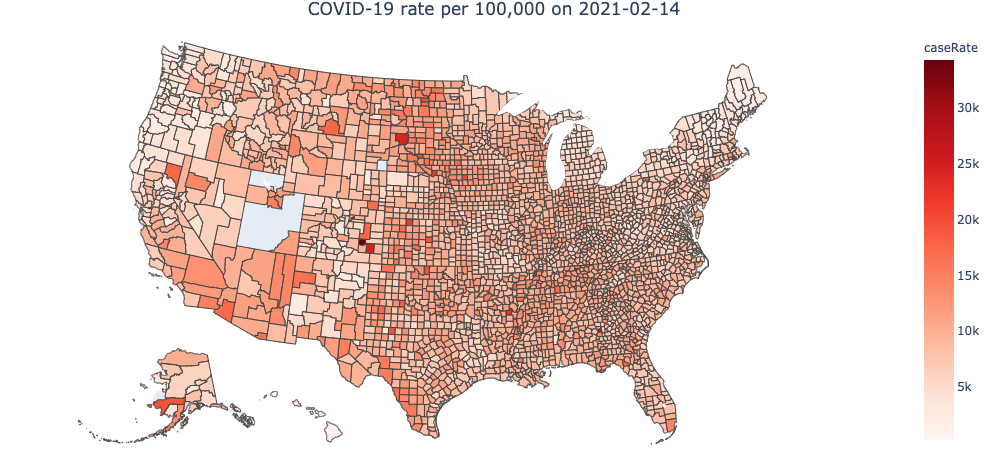

In [13]:
fig = px.choropleth(county_df, geojson=counties, scope='usa',
                    locations='fips', 
                    hover_name='name',
                 #   labels={'caseRate': 'cases per 100.000'},
                    hover_data=['caseRate', 'deathRate', 'cases', 'deaths'],
                    color='caseRate',
                    color_continuous_scale=px.colors.sequential.Reds,
                    )
fig.update_layout(
    title_text = f'COVID-19 rate per 100,000 on {end_date}',
    title_x=0.5,
    margin={"r":0,"l":0,"t":30,"b":0}
)
fig.show()

### Lastest 7-day averages for US counties

In [14]:
query = """
// get all counties (admin2) in a state (admin1)
MATCH (a2:Admin2)-[:IN]->(a1:Admin1)-[:IN]->(:Country{name: $country})

// get COVID-19 cases for counties
MATCH (a2)<-[:REPORTED_IN]-(c:Cases{source: 'JHU'}) 
WHERE c.date >= date($start_date) AND c.date <= date($end_date)

// get demographics for counties
MATCH (a2)-[:HAS_DEMOGRAPHICS]->(d:Demographics) 

RETURN a2.name AS name, a2.stateFips + a2.fips as fips, 
       (max(c.cases)-min(c.cases))*100000.0/$time_period/d.totalPopulation AS caseRate, // average case rate for time period
       (max(c.deaths)-min(c.deaths))*100000.0/$time_period/d.totalPopulation AS deathRate, // average death rate for time period
       (max(c.cases)-min(c.cases))/$time_period AS cases,
       (max(c.deaths)-min(c.deaths))/$time_period AS deaths,
       d.totalPopulation AS population
       
ORDER BY a2.name
"""
county_ave = graph.run(query, country=country, start_date=start_date, end_date=end_date, time_period=TIME_PERIOD).to_data_frame()
county_ave = county_ave.round(2)

In [15]:
county_ave.head()

,name,fips,caseRate,deathRate,cases,deaths,population
0,Abbeville County,45001,74.16,1.74,18,0,24657
1,Acadia Parish,22001,19.41,0.23,12,0,62568
2,Accomack County,51001,27.05,0.00,8,0,32742
3,Ada County,16001,19.98,0.29,89,1,446052
4,Adair County,21001,17.08,0.00,3,0,19241


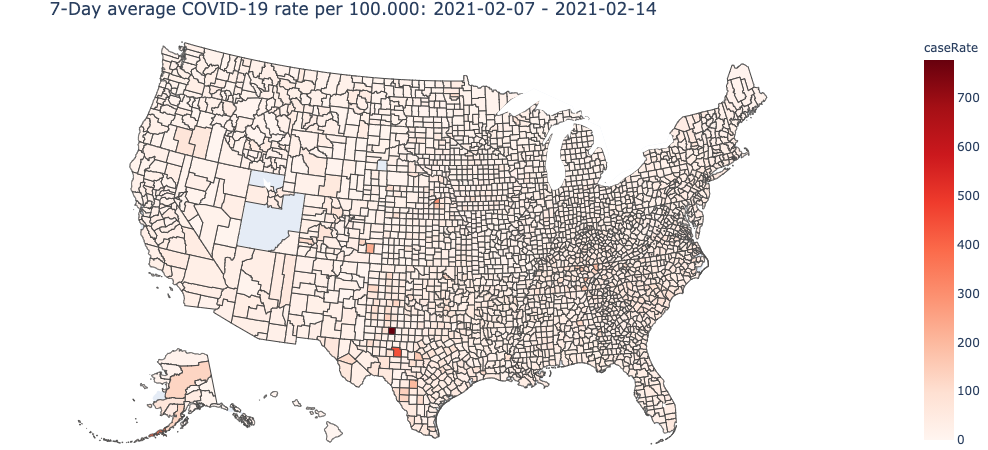

In [16]:
fig = px.choropleth(county_ave, geojson=counties, scope='usa',
                    locations='fips', 
                    hover_name='name',
                    hover_data=['caseRate', 'deathRate', 'cases', 'deaths'],
                    color='caseRate',
                    color_continuous_scale=px.colors.sequential.Reds,
                    )
fig.update_layout(
    title_text = f'{TIME_PERIOD}-Day average COVID-19 rate per 100.000: {start_date} - {end_date}',
    margin={"r":0,"l":0,"t":30,"b":0}
)
fig.show()